In [2]:
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
import netCDF4 as nc
import matplotlib.pyplot as plt
import numpy as np
import copy
import os
import glob
import pylab as pl
import numpy as np
import matplotlib.animation as animation
import types
from mpl_toolkits.basemap import cm,addcyclic,Basemap, shiftgrid
import matplotlib.patches as patches
% matplotlib inline

# ENG3-ENG4-EXH005 2004

In [3]:
nc_filename=sorted(glob.glob('/ocean/xiaoxiny/research/result_jasper/min_ice/nasaRun/Y*2008*.nc'))#*_ptrc_T*.nc'))
print("found *.nc file: \n{}".format(nc_filename))
ptrc=nc.Dataset(nc_filename[0])

found *.nc file: 
['/ocean/xiaoxiny/research/result_jasper/min_ice/nasaRun/Y19682008.nc']


In [4]:
lon=ptrc.variables['nav_lon'][:,:]
lat=ptrc.variables['nav_lat'][:,:]
dep = ptrc.variables['deptht'][:]


tmask=nc.Dataset(
        '/ocean/xiaoxiny/research/data/mesh_mask_anha4_201509.nc')
mbathy=tmask.variables['mbathy'][0,400:,:]
tmask=tmask.variables['tmask'][0,:,400:,:]


bathy=nc.Dataset(
    '/ocean/xiaoxiny/research/data/Jasper/ANHA4_bathy_etopo1_gebco1_smoothed_coast_corrected_mar10.nc')
bathy=bathy.variables['Bathymetry'][400:,:]

In [5]:
yearnum=1

1 ==> the same

2 ==> ENG3 is twice of ENG4

0.5 ==> ENG4 is half of ENG3

In [6]:
def vel(keyword,T,ENG):
    'design to obtain velocity field'
    if keyword =='U':
        nc_filename=sorted(glob.glob('/ocean/xiaoxiny/research/result_jasper/data_eng3/*%s*U*%s*.nc'%(ENG,T)))
        #print nc_filename
        uvel=nc.Dataset(nc_filename[0])
        data =uvel.variables['vozocrtx'][0,:,400:,:]
    elif keyword =='V':
        nc_filename=sorted(glob.glob('/ocean/xiaoxiny/research/result_jasper/data_eng3/*%s*V*%s*.nc'%(ENG,T)))
        vvel=nc.Dataset(nc_filename[0])
        data =vvel.variables['vomecrty'][0,:,400:,:]
    else:
        nc_filename=sorted(glob.glob('/ocean/xiaoxiny/research/result_jasper/data_eng3/*%s*W*%s*.nc'%(ENG,T)))
        wvel=nc.Dataset(nc_filename[0])
        data =wvel.variables['vovecrtz'][0,:,400:,:]
    data =np.ma.masked_where(tmask==0,data)
    return data

In [7]:
layer=38
k=0
lon=ptrc.variables['nav_lon'][:,:]
lat=ptrc.variables['nav_lat'][:,:]
x1d=np.linspace(0,lon[:,0].shape[0],lon[:,0].shape[0])
y1d=np.linspace(0,lon[0,:].shape[0],lon[0,:].shape[0])
x2d,y2d=np.meshgrid(y1d,x1d)

# plot the velocity field at depeth 1000m (ENG3, ENG4, EXH005)

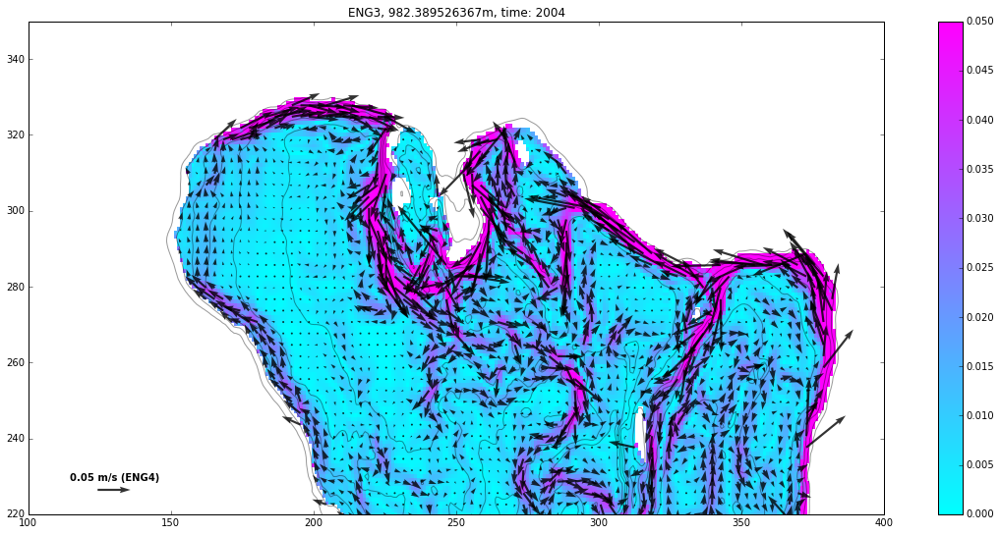

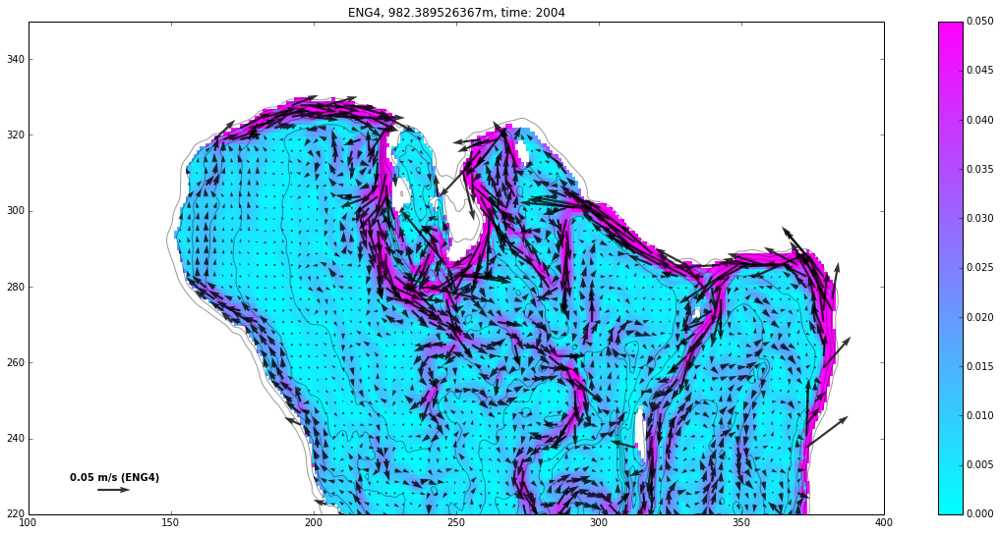

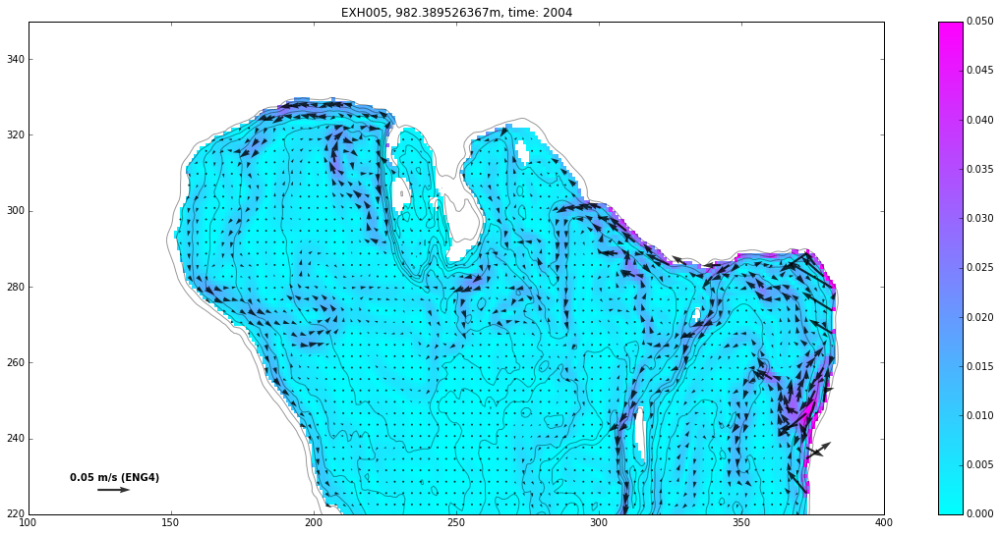

In [25]:
yearnum=8
k=0
layer = 35
for i,input_Y,input_N in zip ([35,2,2],[1969,2002,2002],['ENG3','ENG4','EXH005']):

    #range (yearnum):
    time =i
    
    x_lon,y_lat = lon,lat
    
    U =vel('U',time+input_Y,input_N)
    V =vel('V',time+input_Y,input_N)

    
    
    fig = plt.figure(figsize=(13*1.5,6*1.5))
    
    ax = fig.add_subplot(111)
    #velocity
    speed=(U[layer,:,:]**2+ V[layer,:,:]**2)**0.5
    plt.pcolor(x2d[:,:], y2d[:,:], speed[:,:],cmap='cool',vmin=0,vmax=0.05);plt.colorbar()
    
    #mask too large value so that the vector plot can look good
    u =np.ma.masked_where(abs(V)>0.1,U)
    v =np.ma.masked_where(abs(V)>0.1,V)
    u =np.ma.masked_where(abs(U)>0.1,u)
    v =np.ma.masked_where(abs(U)>0.1,v)
    #vector
    Q=plt.quiver(x2d[::3,::3], y2d[::3,::3], u[layer,::3,::3], v[layer,::3,::3],
               scale=1.3,width=0.0025,color='k',alpha=0.8)
    Qlabel=plt.quiverkey(Q,0.1, 0.05, 0.05, '0.05 m/s (ENG4)',fontproperties={'weight': 'bold'})
    plt.contour(bathy,linewidth=0.075,colors='black',alpha=0.4)
    plt.ylim(220,350)    
    plt.xlim(100,400)
    
    
    plt.title('%s, %sm, time: %s'%(input_N,(dep[layer]+dep[layer-1])/2,time+input_Y))
    k+=1

# plot the difference between eng3 and eng4. 

(because the colorbar is limited, it's hard to tell their difference from the plot above)

['/ocean/xiaoxiny/research/result_jasper/data_eng3/ANHA4-ENG3_gridUyear2004.nc']
['/ocean/xiaoxiny/research/result_jasper/data_eng3/ANHA4-ENG4_gridUyear2004.nc']


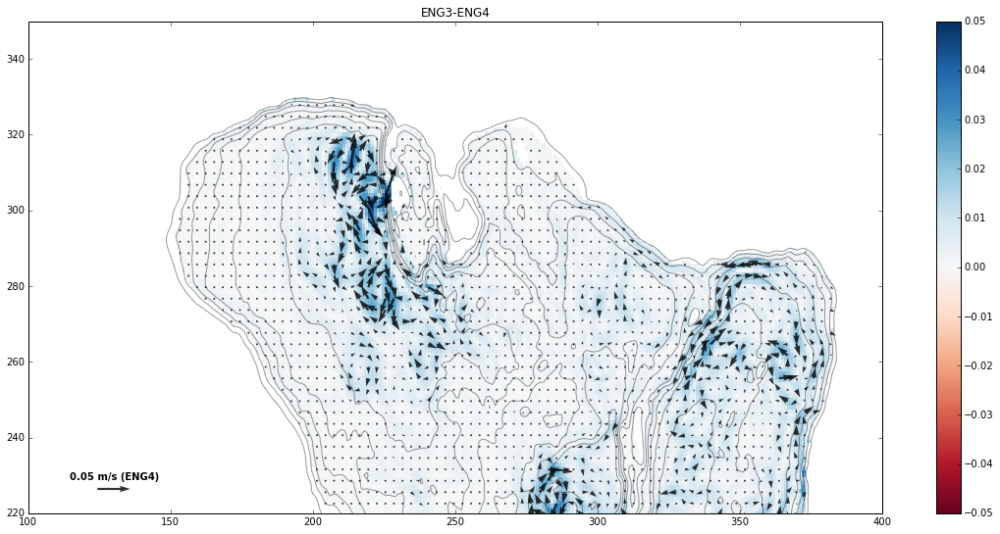

In [16]:
layer = 35
for i,input_Y,input_N in zip ([35,2],[1969,2002],['ENG3','ENG4']):

    #range (yearnum):
    time =i
    
    x_lon,y_lat = lon,lat
    
    U =vel('U',time+input_Y,input_N)
    V =vel('V',time+input_Y,input_N)
    if i ==35:
        U3=U
        V3=V
    if i ==2:
        U=U3-U
        V=V3-V

    
    
fig = plt.figure(figsize=(13*1.5,6*1.5))

ax = fig.add_subplot(111)
#velocity
speed=(U[layer,:,:]**2+ V[layer,:,:]**2)**0.5
plt.pcolor(x2d[:,:], y2d[:,:], speed[:,:],cmap='RdBu',vmin=-0.05,vmax=0.05);plt.colorbar()

#mask too large value so that the vector plot can look good
u =np.ma.masked_where(abs(V)>0.1,U)
v =np.ma.masked_where(abs(V)>0.1,V)
u =np.ma.masked_where(abs(U)>0.1,u)
v =np.ma.masked_where(abs(U)>0.1,v)
#vector
Q=plt.quiver(x2d[::3,::3], y2d[::3,::3], u[layer,::3,::3], v[layer,::3,::3],
           scale=1.3,width=0.0025,color='k',alpha=0.8)
Qlabel=plt.quiverkey(Q,0.1, 0.05, 0.05, '0.05 m/s (ENG4)',fontproperties={'weight': 'bold'})
plt.contour(bathy,linewidth=0.075,colors='black',alpha=0.4)
plt.ylim(220,350)    
plt.xlim(100,400)
plt.title('ENG3-ENG4')

In [19]:
# plot the other years in ENG4 and EXH005

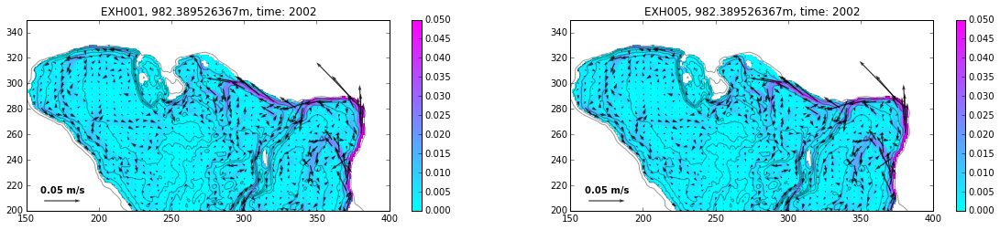

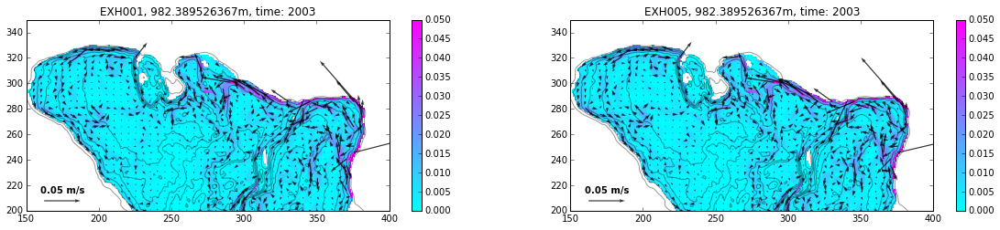

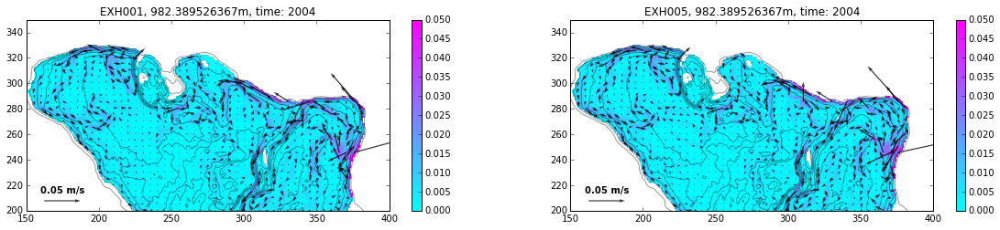

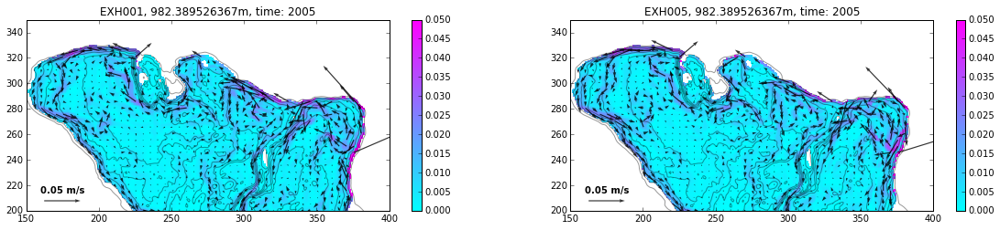

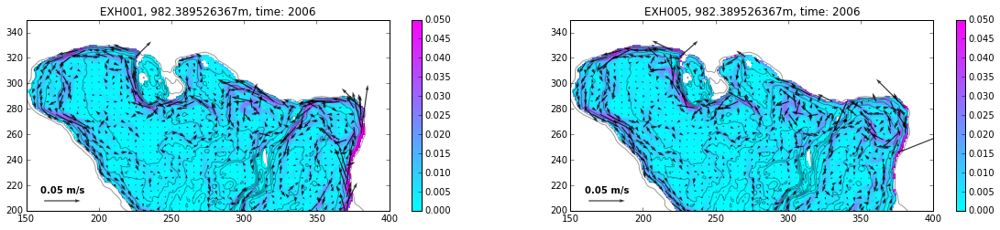

...

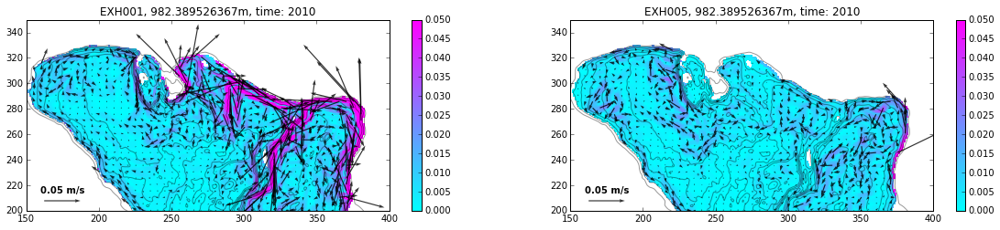

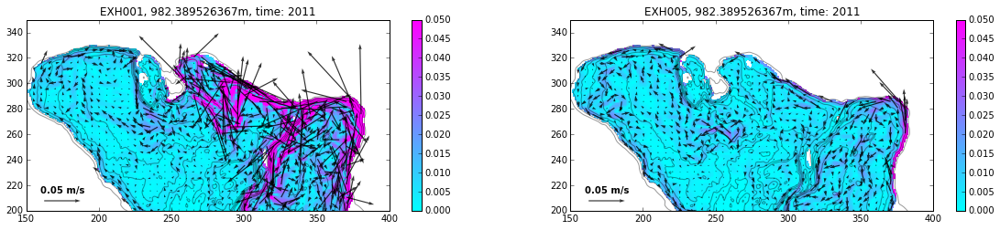

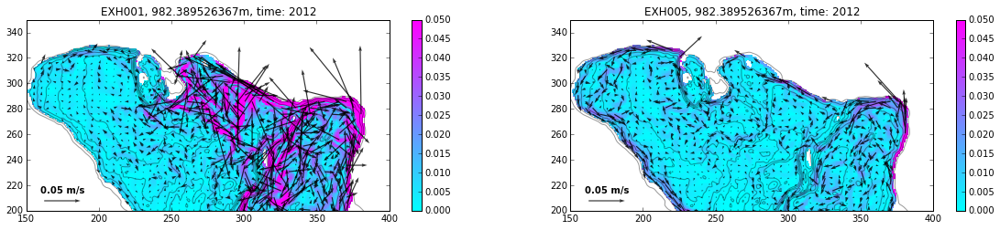

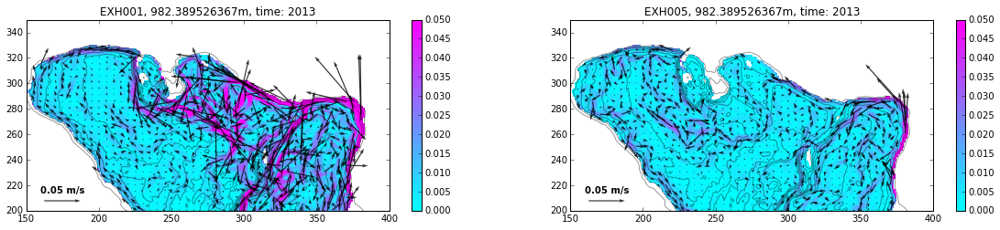

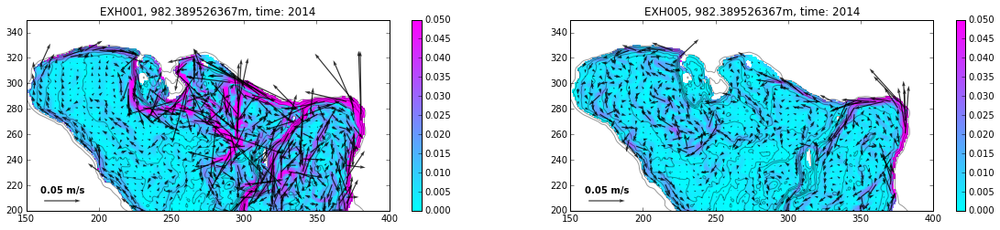

In [12]:
layer = 35

for num in range (13):
    k = 0
    fig = plt.figure(figsize=(13*1.5,2.5*1.5))
    for i,input_Y,input_N in zip ([num,num],[2002,2002],['EXH001','EXH005']):

        #range (yearnum):
        time =i

        x_lon,y_lat = lon,lat

        U =vel('U',time+input_Y,input_N);V =vel('V',time+input_Y,input_N)


        ax = fig.add_subplot(1,2,k+1)
        #velocity
        speed=(U[layer,:,:]**2+ V[layer,:,:]**2)**0.5
        plt.pcolor(x2d[:,:], y2d[:,:], speed[:,:],cmap='cool',vmin=0,vmax=0.05);plt.colorbar()

        #mask too large value so that the vector plot can look good
        u =np.ma.masked_where(abs(V)>0.1,U);v =np.ma.masked_where(abs(V)>0.1,V)
        u =np.ma.masked_where(abs(U)>0.1,u);v =np.ma.masked_where(abs(U)>0.1,v)
        #vector
        Q=plt.quiver(x2d[::5,::5], y2d[::5,::5], u[layer,::5,::5], v[layer,::5,::5],
                   scale=0.5,width=0.003,color='k',alpha=0.8)
        Qlabel=plt.quiverkey(Q,0.1, 0.05, 0.05, '0.05 m/s ',fontproperties={'weight': 'bold'})
        plt.contour(bathy,linewidth=0.075,colors='black',alpha=0.4)
        plt.ylim(200,350);plt.xlim(150,400)
        k+=1


        plt.title('%s, %sm, time: %s'%(input_N,(dep[layer]+dep[layer-1])/2,input_Y+time))


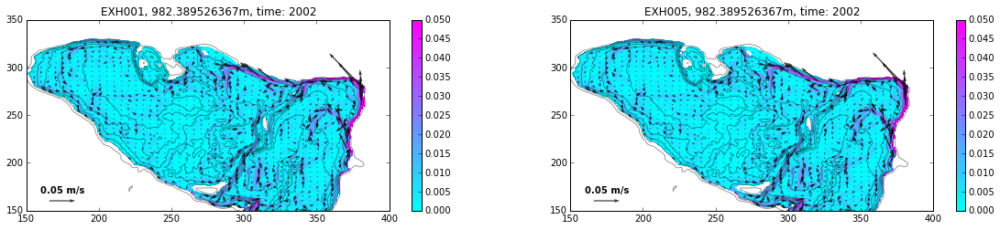

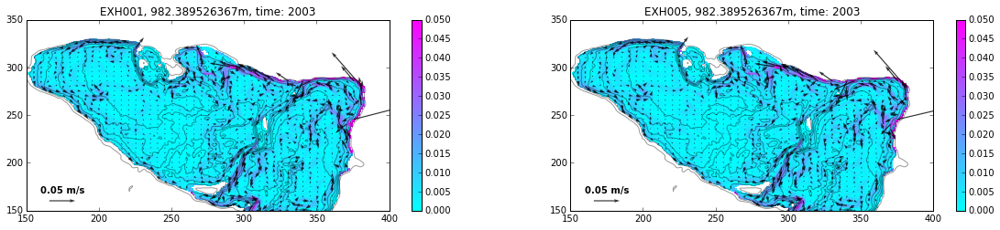

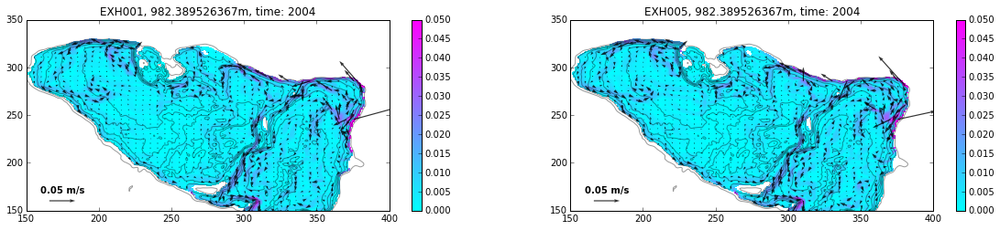

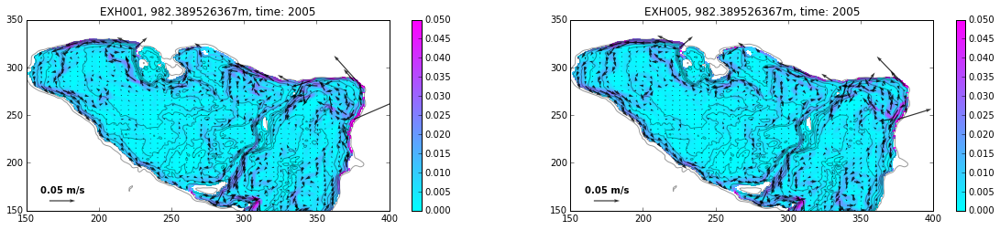

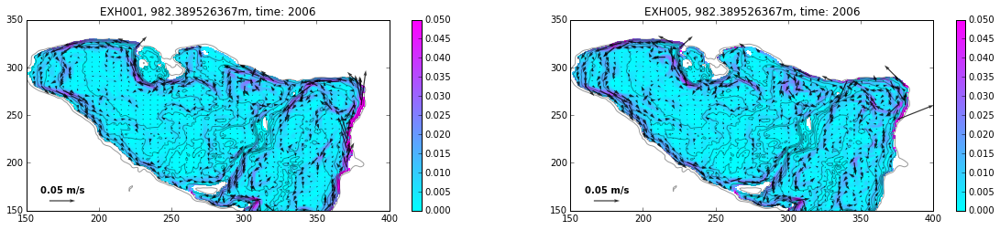

...

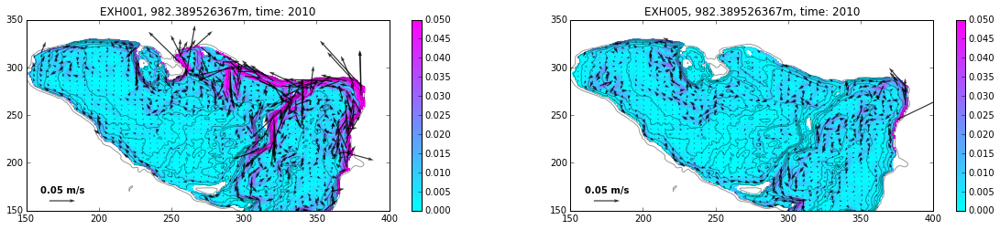

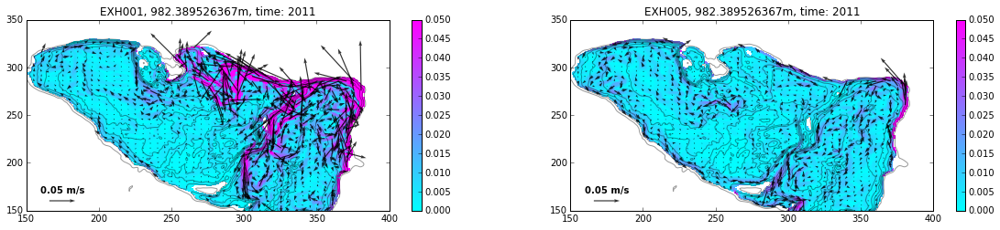

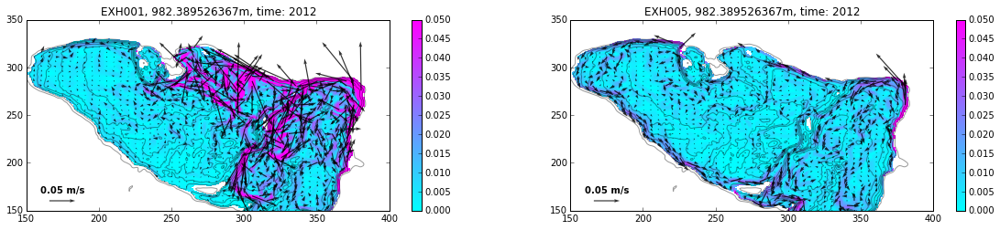

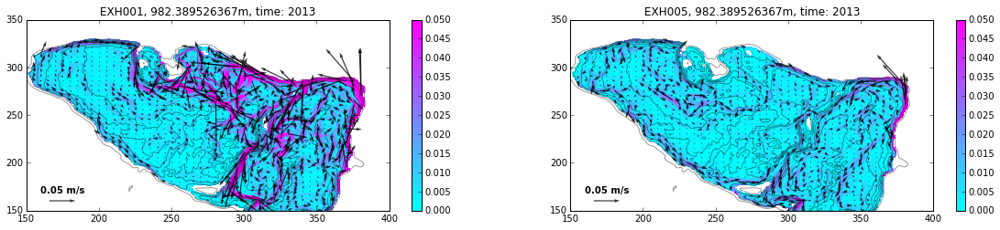

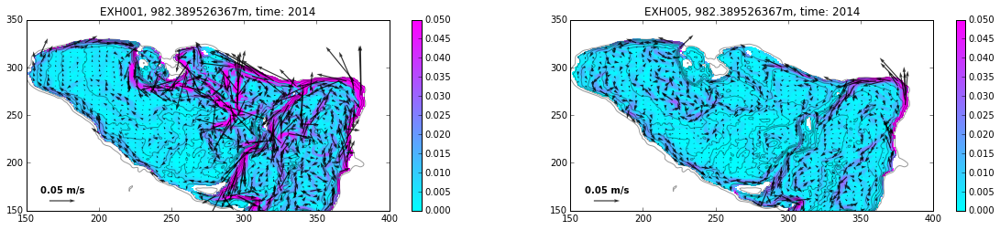

In [14]:
layer = 35

for num in range (13):
    k = 0
    fig = plt.figure(figsize=(13*1.5,2.5*1.5))
    for i,input_Y,input_N in zip ([num,num],[2002,2002],['EXH001','EXH005']):

        #range (yearnum):
        time =i

        x_lon,y_lat = lon,lat

        U =vel('U',time+input_Y,input_N);V =vel('V',time+input_Y,input_N)


        ax = fig.add_subplot(1,2,k+1)
        #velocity
        speed=(U[layer,:,:]**2+ V[layer,:,:]**2)**0.5
        plt.pcolor(x2d[:,:], y2d[:,:], speed[:,:],cmap='cool',vmin=0,vmax=0.05);plt.colorbar()

        #mask too large value so that the vector plot can look good
        u =np.ma.masked_where(abs(V)>0.1,U);v =np.ma.masked_where(abs(V)>0.1,V)
        u =np.ma.masked_where(abs(U)>0.1,u);v =np.ma.masked_where(abs(U)>0.1,v)
        #vector
        Q=plt.quiver(x2d[::5,::5], y2d[::5,::5], u[layer,::5,::5], v[layer,::5,::5],
                   scale=0.7,width=0.003,color='k',alpha=0.8)
        Qlabel=plt.quiverkey(Q,0.1, 0.05, 0.05, '0.05 m/s ',fontproperties={'weight': 'bold'})
        plt.contour(bathy,linewidth=0.075,colors='black',alpha=0.4)
        plt.ylim(150,350);plt.xlim(150,400)
        k+=1


        plt.title('%s, %sm, time: %s'%(input_N,(dep[layer]+dep[layer-1])/2,input_Y+time))


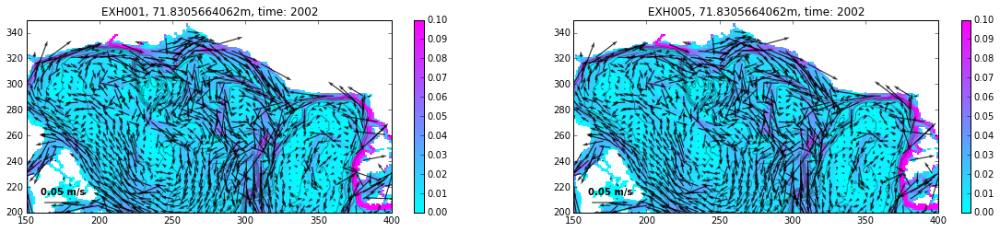

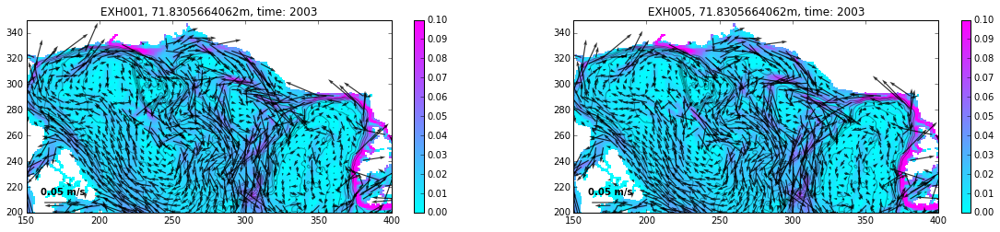

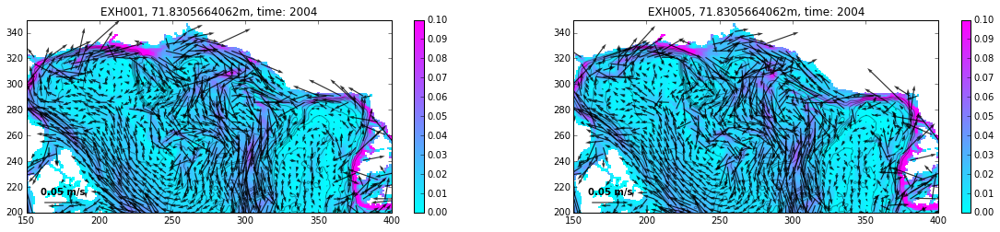

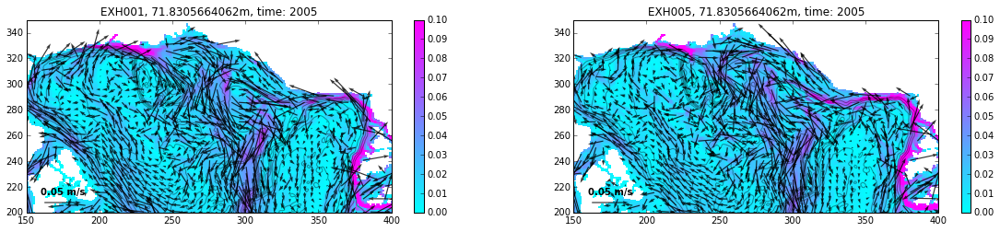

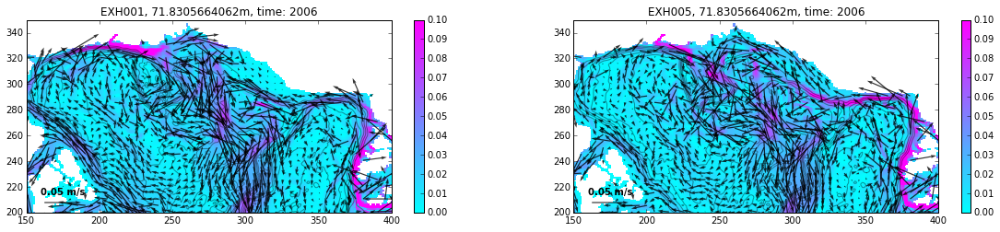

...

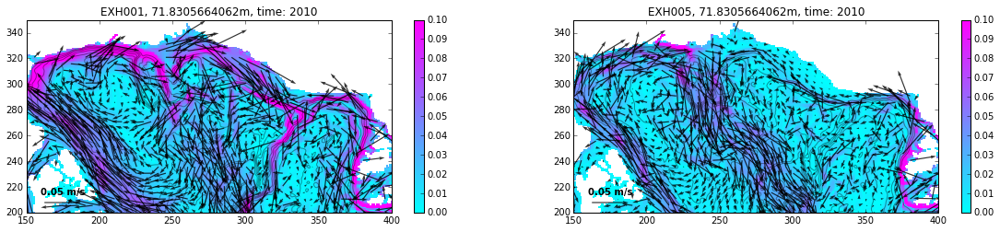

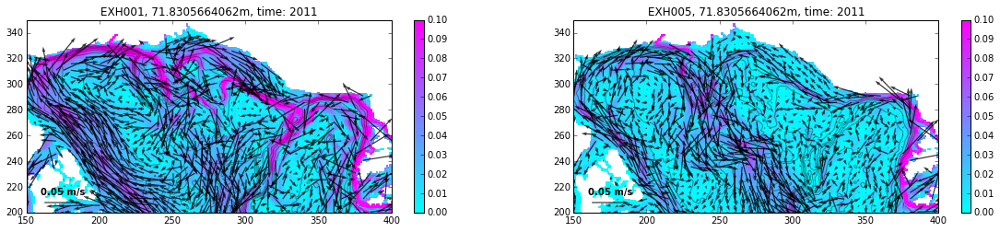

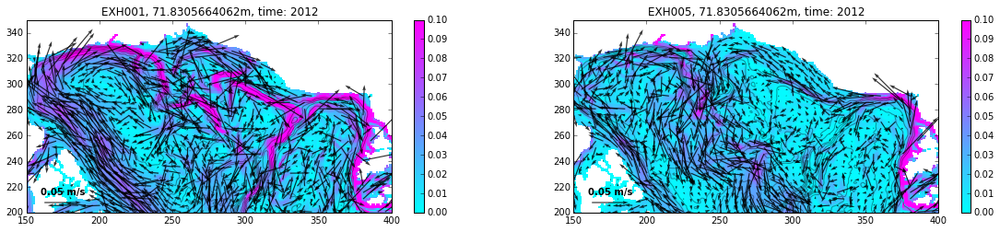

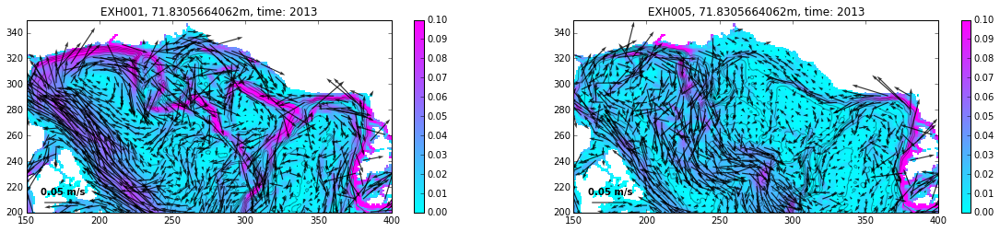

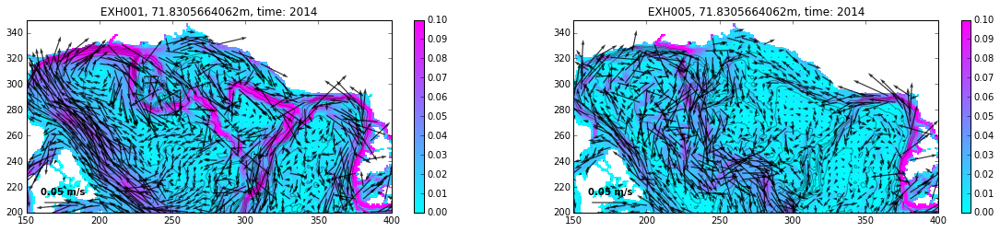

In [19]:
layer = 20

for num in range (13):
    k = 0
    fig = plt.figure(figsize=(13*1.5,2.5*1.5))
    for i,input_Y,input_N in zip ([num,num],[2002,2002],['EXH001','EXH005']):

        #range (yearnum):
        time =i

        x_lon,y_lat = lon,lat

        U =vel('U',time+input_Y,input_N);V =vel('V',time+input_Y,input_N)


        ax = fig.add_subplot(1,2,k+1)
        #velocity
        speed=(U[layer,:,:]**2+ V[layer,:,:]**2)**0.5
        plt.pcolor(x2d[:,:], y2d[:,:], speed[:,:],cmap='cool',vmin=0,vmax=0.1);plt.colorbar()

        #mask too large value so that the vector plot can look good
        u =np.ma.masked_where(abs(V)>0.05,U);v =np.ma.masked_where(abs(V)>0.05,V)
        u =np.ma.masked_where(abs(U)>0.05,u);v =np.ma.masked_where(abs(U)>0.05,v)
        #vector
        Q=plt.quiver(x2d[::5,::5], y2d[::5,::5], u[layer,::5,::5], v[layer,::5,::5],
                   scale=0.5,width=0.003,color='k',alpha=0.8)
        Qlabel=plt.quiverkey(Q,0.1, 0.05, 0.05, '0.05 m/s ',fontproperties={'weight': 'bold'})
        plt.contour(bathy,linewidth=0.075,colors='black',alpha=0.4)
        plt.ylim(200,350);plt.xlim(150,400)
        k+=1


        plt.title('%s, %sm, time: %s'%(input_N,(dep[layer]+dep[layer-1])/2,input_Y+time))


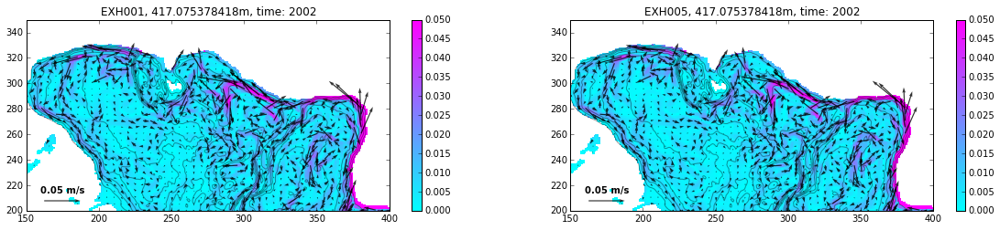

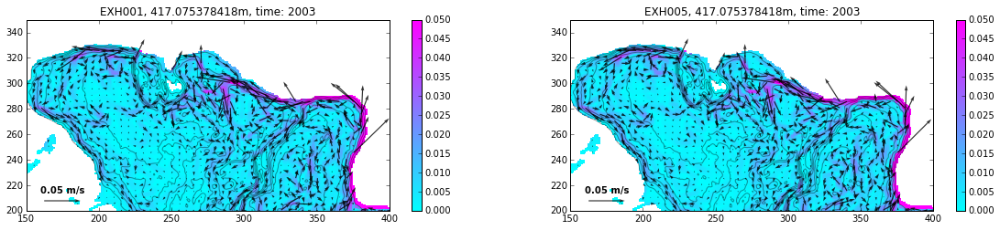

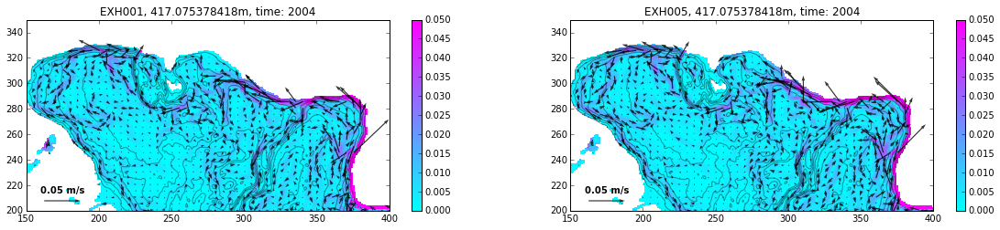

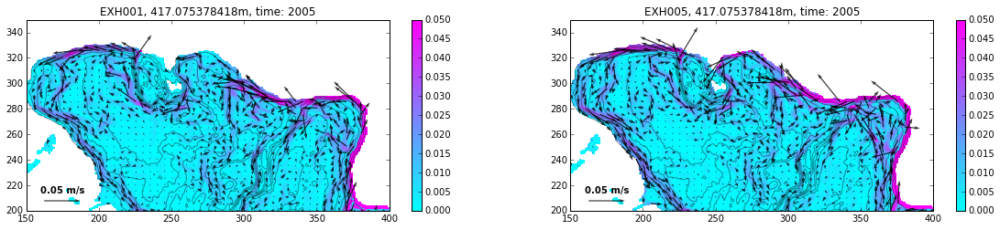

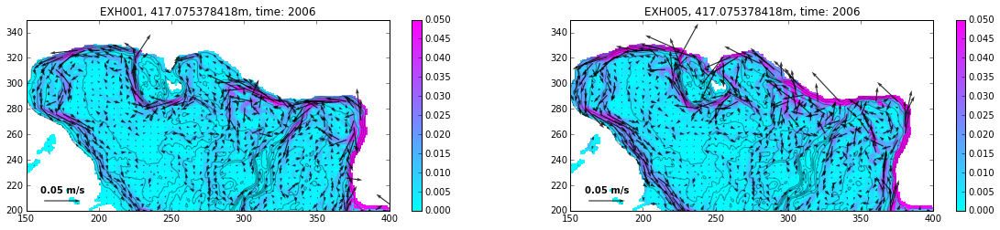

...

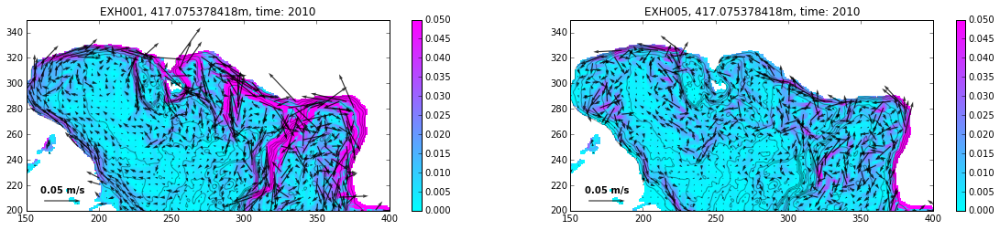

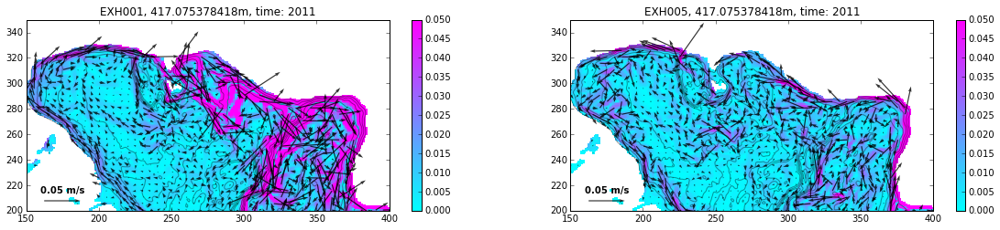

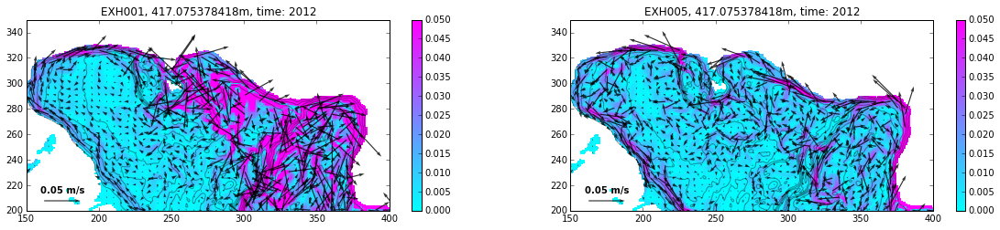

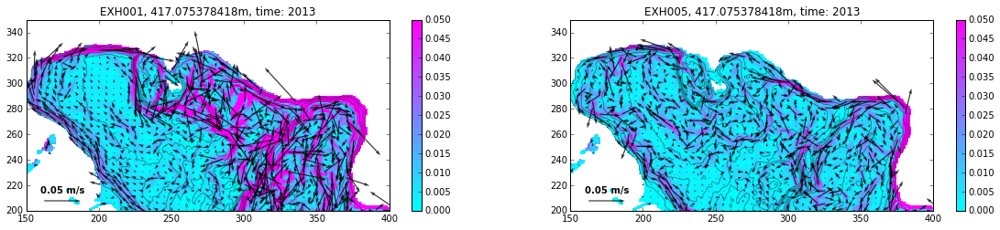

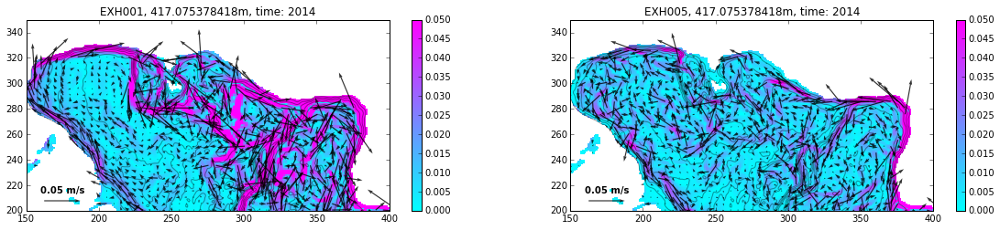

In [15]:
layer = 30

for num in range (13):
    k = 0
    fig = plt.figure(figsize=(13*1.5,2.5*1.5))
    for i,input_Y,input_N in zip ([num,num],[2002,2002],['EXH001','EXH005']):

        #range (yearnum):
        time =i

        x_lon,y_lat = lon,lat

        U =vel('U',time+input_Y,input_N);V =vel('V',time+input_Y,input_N)


        ax = fig.add_subplot(1,2,k+1)
        #velocity
        speed=(U[layer,:,:]**2+ V[layer,:,:]**2)**0.5
        plt.pcolor(x2d[:,:], y2d[:,:], speed[:,:],cmap='cool',vmin=0,vmax=0.05);plt.colorbar()

        #mask too large value so that the vector plot can look good
        u =np.ma.masked_where(abs(V)>0.05,U);v =np.ma.masked_where(abs(V)>0.05,V)
        u =np.ma.masked_where(abs(U)>0.05,u);v =np.ma.masked_where(abs(U)>0.05,v)
        #vector
        Q=plt.quiver(x2d[::5,::5], y2d[::5,::5], u[layer,::5,::5], v[layer,::5,::5],
                   scale=0.5,width=0.003,color='k',alpha=0.8)
        Qlabel=plt.quiverkey(Q,0.1, 0.05, 0.05, '0.05 m/s ',fontproperties={'weight': 'bold'})
        plt.contour(bathy,linewidth=0.075,colors='black',alpha=0.4)
        plt.ylim(200,350);plt.xlim(150,400)
        k+=1


        plt.title('%s, %sm, time: %s'%(input_N,(dep[layer]+dep[layer-1])/2,input_Y+time))
